In [93]:
import tensorflow as tf
import matplotlib.pyplot as plt
import os
from PIL import Image
import numpy as np
import pandas as pd
import glob
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_input_mbnv2
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_input_rsn50
from tensorflow.keras.applications.efficientnet import EfficientNetB0
from tensorflow.keras.applications.efficientnet import preprocess_input as preprocess_input_en
from bing_image_downloader import downloader

import random

# Convolutional Neural Network-Powered Food Recognition: Smarter Sorting for Fruits and Vegetables

### By Azizkhuja Asomiddinov

# Loading Dataset
#### This line might take several tries to download dataset, repeat until its done

In [94]:
import datasets

ds = datasets.load_dataset("SunnyAgarwal4274/Food_and_Vegetables")

# Saving Dataset locally (optional)

In [95]:
# save_dir = "Food_and_Vegetables_images"
# if not os.path.exists(save_dir):
#     os.makedirs(save_dir)

# # Iterate through each split (e.g., train, test)
# for split_name, split_ds in ds.items():
#     # Create a subdirectory for the current split
#     split_dir = os.path.join(save_dir, split_name)
#     if not os.path.exists(split_dir):
#         os.makedirs(split_dir)
    
#     # Iterate through examples in the current split
#     for idx, example in enumerate(split_ds):
#         # Assuming the image field is named "image"
#         image_data = example["image"]
        
#         # If the image data is already a PIL image, use it directly.
#         # Otherwise, convert the numpy array to a PIL image.
#         if hasattr(image_data, "save"):
#             pil_image = image_data
#         else:
#             pil_image = Image.fromarray(image_data)
        
#         # Convert CMYK images to RGB to avoid the PNG save error.
#         if pil_image.mode == "CMYK":
#             pil_image = pil_image.convert("RGB")
        
#         # Optionally, include label information in the file name if available.
#         label_info = example.get("label")
#         if label_info is not None:
#             file_name = f"image_{idx}_label_{label_info}.png"
#         else:
#             file_name = f"image_{idx}.png"
            
#         # Define the full file path and save the image
#         file_path = os.path.join(split_dir, file_name)
#         pil_image.save(file_path)
        
# print(f"All images have been saved in the directory: {save_dir}")

# Dataset contents

In [96]:
ds.shape

{'train': (3114, 2), 'validation': (351, 2)}

# Dataset Overview

In [97]:
train_ds = ds["train"]

categories = train_ds.features["label"].names

len(categories)

36

In [98]:

categories_array = np.array(categories).reshape(6, 6)
FnV = pd.DataFrame(categories_array)
FnV

,0,1,2,3,4,5
0,apple,banana,beetroot,bell pepper,cabbage,capsicum
1,carrot,cauliflower,chilli pepper,corn,cucumber,eggplant
2,garlic,ginger,grapes,jalepeno,kiwi,lemon
3,lettuce,mango,onion,orange,paprika,pear
4,peas,pineapple,pomegranate,potato,raddish,soy beans
5,spinach,sweetcorn,sweetpotato,tomato,turnip,watermelon


# Dataset Visual Overview

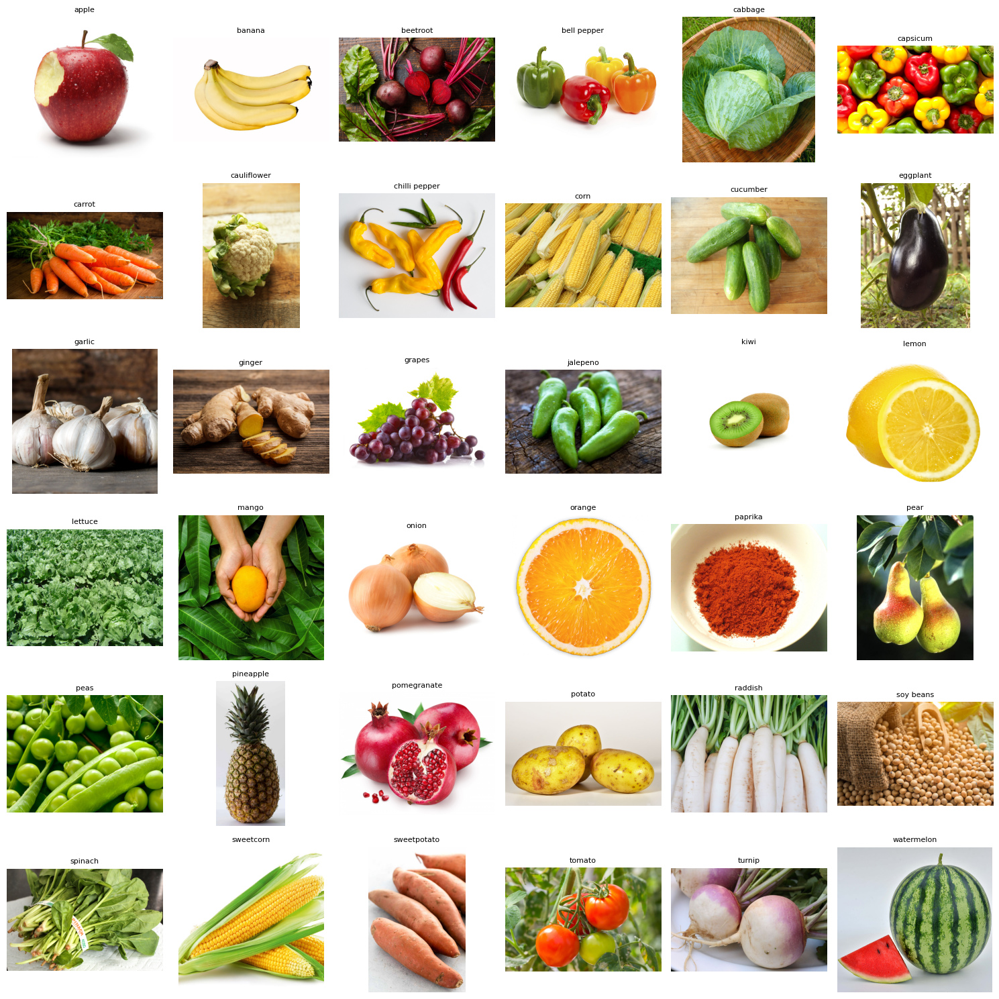

In [99]:
# Dictionary to hold one image per category
category_images = {}

# Iterate through the dataset once to collect one image per category
for example in train_ds:
    label = example["label"]
    if label not in category_images:
        category_images[label] = example["image"]
    # Stop if we have an image for every category
    if len(category_images) == len(categories):
        break

# Create a 6x6 grid to display the images
fig, axes = plt.subplots(6, 6, figsize=(15, 15))
axes = axes.flatten()

for idx in range(len(categories)):
    # Get the corresponding image for the category
    image = category_images[idx]
    axes[idx].imshow(image)
    axes[idx].set_title(categories[idx], fontsize=8)
    axes[idx].axis("off")

plt.tight_layout()
plt.show()

# Data preprocessing

#### Ensures all images have a consistent shape (128x128x3) for CNN training.
#### Converts images to tensors with float32 precision, making them compatible with TensorFlow operations.
#### Normalizes pixel values to [0,1], improving stability and model convergence speed.
#### Efficiently separates images and labels, preparing them for training and validation.
#### Converts tensors to NumPy arrays, allowing for flexible data manipulation when needed.

#### This preprocessing pipeline ensures that the dataset is clean, structured, and ready for efficient training in a CNN-based image classification model.

In [100]:
IMG_SIZE = (128, 128)
NUM_CLASSES = 36

def preprocess(example):
    # Force the PIL image to be in RGB mode.
    image = example["image"].convert("RGB")
    image = np.array(image)
    
    # Convert to tensor, resize, and normalize
    image = tf.convert_to_tensor(image, dtype=tf.float32)
    image = tf.image.resize(image, IMG_SIZE)
    image = image / 255.0  # Normalize to [0, 1]
    
    label = example["label"]
    return image, label

# Load the dataset (assuming ds is already loaded)
train_data = ds["train"]
val_data = ds["validation"]

# Process the datasets once
train_samples = [preprocess(example) for example in train_data]
val_samples = [preprocess(example) for example in val_data]

# Unzip images and labels
train_images, train_labels = zip(*train_samples)
val_images, val_labels = zip(*val_samples)

# Convert tensors to numpy arrays (they now all should have shape (128, 128, 3))
train_images = np.stack([img.numpy() for img in train_images])
train_labels = np.array(train_labels)
val_images = np.stack([img.numpy() for img in val_images])
val_labels = np.array(val_labels)

print("Train images shape:", train_images.shape)
print("Validation images shape:", val_images.shape)

C:\Users\mi6xi\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train images shape: (3114, 128, 128, 3)
Validation images shape: (351, 128, 128, 3)


# Two Epoch Model

#### Basic CNN architecture used as a baseline for image classification.
#### One convolutional layer with 4 filters (3×3, ReLU activation) for feature extraction.
#### One max pooling layer to reduce spatial dimensions.
#### Flatten layer to convert feature maps into a vector.
#### Dense softmax output layer for classification into 36 classes.
#### Trained for 2 epochs, providing a quick evaluation of initial model performance.
#### Limited feature extraction leads to underfitting and lower accuracy, but establishes a foundation for deeper models

C:\Users\mi6xi\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_24 (Conv2D)              │ (None, 126, 126, 4)    │           112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 63, 63, 4)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 15876)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 36)             │       571,572 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 571,684 (2.18 MB)

 Trainable params: 571,684 (2.18 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/2
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.0823 - loss: 3.9340 - val_accuracy: 0.4957 - val_loss: 2.2084
Epoch 2/2
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.3616 - loss: 2.4056 - val_accuracy: 0.7265 - val_loss: 1.4575


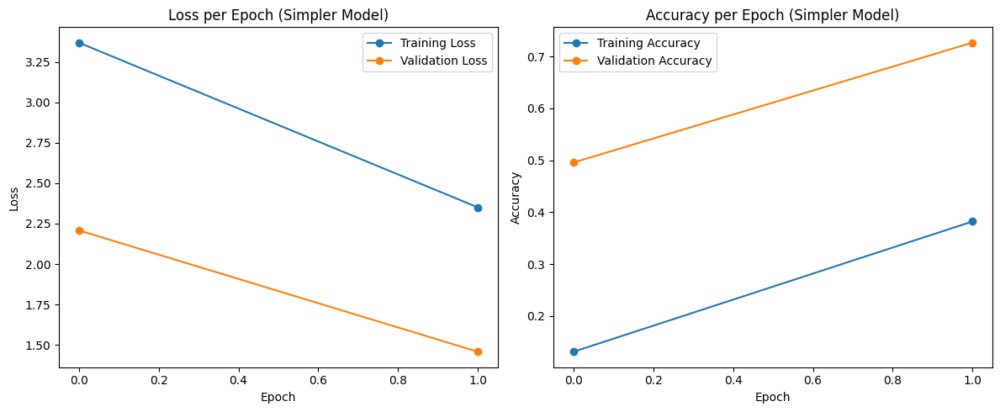

In [101]:
two_epoch_model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(4, (3, 3), activation='relu', input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

# Compile the two_epoch_model.
two_epoch_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

two_epoch_model.summary()

# Train the two_epoch_model.
two_epoch_history = two_epoch_model.fit(
    train_images, train_labels,
    epochs=2,
    validation_data=(val_images, val_labels)
)

# Plot training and validation loss and accuracy per epoch.
plt.figure(figsize=(12, 5))

# Plot Loss
plt.subplot(1, 2, 1)
plt.plot(two_epoch_history.history['loss'], marker='o', label='Training Loss')
plt.plot(two_epoch_history.history['val_loss'], marker='o', label='Validation Loss')
plt.title("Loss per Epoch (Simpler Model)")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

# Plot Accuracy
plt.subplot(1, 2, 2)
plt.plot(two_epoch_history.history['accuracy'], marker='o', label='Training Accuracy')
plt.plot(two_epoch_history.history['val_accuracy'], marker='o', label='Validation Accuracy')
plt.title("Accuracy per Epoch (Simpler Model)")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


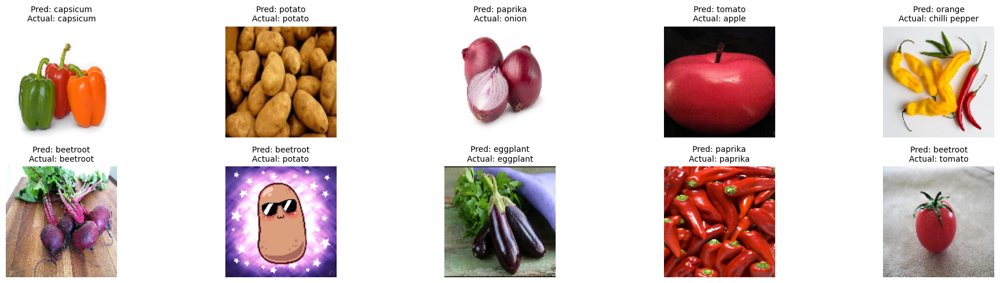

In [102]:
# Choose 10 random indices from the validation dataset.
num_samples = 10
random_indices = np.random.choice(len(val_images), size=num_samples, replace=False)

# Select the images corresponding to these indices
selected_images = val_images[random_indices]
# Predict the classes for these images
predictions = two_epoch_model.predict(selected_images)
pred_labels = np.argmax(predictions, axis=1)
actual_labels = val_labels[random_indices]

# Plot the images with predicted and actual labels
plt.figure(figsize=(20, 5))
for i in range(num_samples):
    idx = random_indices[i]
    plt.subplot(2, 5, i+1)
    plt.imshow(val_images[idx])
    plt.axis("off")
    plt.title(f"Pred: {categories[pred_labels[i]]}\nActual: {categories[actual_labels[i]]}", fontsize=10)
plt.tight_layout()
plt.show()

# Five Epoch Model

#### Enhanced CNN architecture with increased depth for better feature extraction.
#### Two convolutional layers:
#### First layer: 8 filters (3×3, ReLU activation).
#### Second layer: 16 filters (3×3, ReLU activation).
#### Two max pooling layers to progressively reduce spatial dimensions.
#### Flatten layer to convert feature maps into a vector for classification.
#### Dense softmax output layer for classifying into 36 classes.
#### Trained for 5 epochs, allowing more learning compared to the two-epoch model.
#### Better feature extraction and improved accuracy, but still not fully optimized.
#### Lays the groundwork for deeper models by increasing complexity without excessive overfitting.

Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_25 (Conv2D)              │ (None, 126, 126, 8)    │           224 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 63, 63, 8)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 61, 61, 16)     │         1,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 30, 30, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 14400)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 36)             │       518,436 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 519,828 (1.98 MB)

 Trainable params: 519,828 (1.98 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.0663 - loss: 3.5355 - val_accuracy: 0.3761 - val_loss: 2.4208
Epoch 2/5
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.3528 - loss: 2.3914 - val_accuracy: 0.7407 - val_loss: 1.1616
Epoch 3/5
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.6471 - loss: 1.3929 - val_accuracy: 0.8689 - val_loss: 0.6161
Epoch 4/5
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8269 - loss: 0.7571 - val_accuracy: 0.9402 - val_loss: 0.3417
Epoch 5/5
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.9269 - loss: 0.3698 - val_accuracy: 0.9516 - val_loss: 0.2911


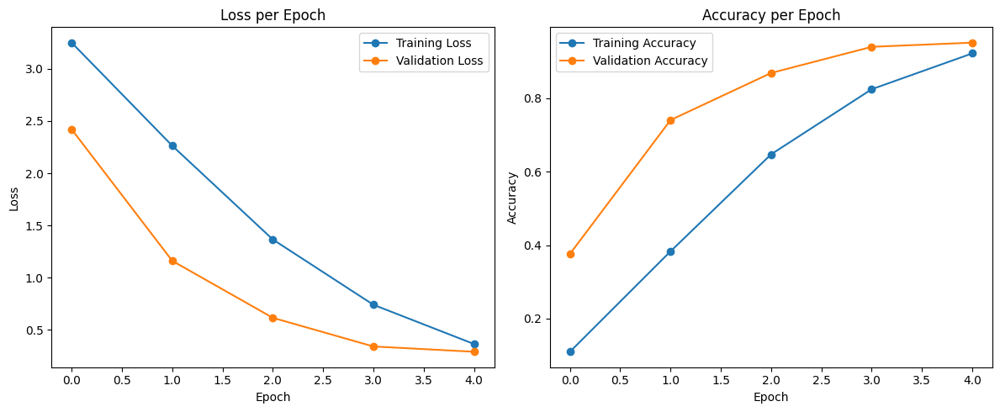

In [103]:

five_epoch_model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(8, (3, 3), activation='relu', input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(16, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

# Compile the five_epoch_model.
five_epoch_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

five_epoch_model.summary()

# Train the five_epoch_model.
five_epoch_history = five_epoch_model.fit(
    train_images, train_labels,
    epochs=5,
    validation_data=(val_images, val_labels)
)

# Plot training and validation loss and accuracy per epoch.
plt.figure(figsize=(12, 5))

# Plot Loss
plt.subplot(1, 2, 1)
plt.plot(five_epoch_history.history['loss'], marker='o', label='Training Loss')
plt.plot(five_epoch_history.history['val_loss'], marker='o', label='Validation Loss')
plt.title("Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

# Plot Accuracy
plt.subplot(1, 2, 2)
plt.plot(five_epoch_history.history['accuracy'], marker='o', label='Training Accuracy')
plt.plot(five_epoch_history.history['val_accuracy'], marker='o', label='Validation Accuracy')
plt.title("Accuracy per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


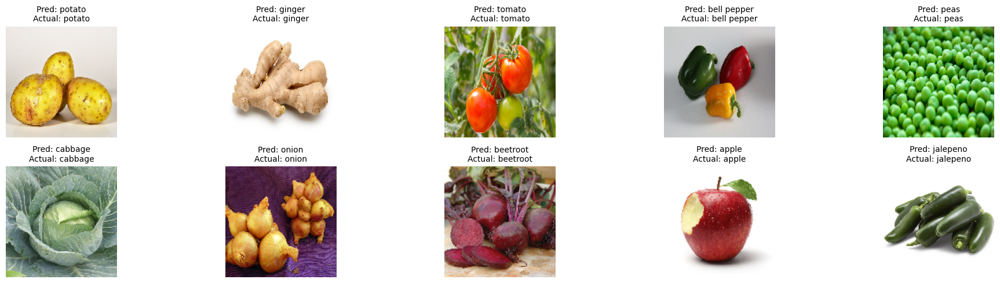

In [104]:
# Choose 10 random indices from the validation dataset.
num_samples = 10
random_indices = np.random.choice(len(val_images), size=num_samples, replace=False)

# Select the images corresponding to these indices
selected_images = val_images[random_indices]
# Predict the classes for these images
predictions = five_epoch_model.predict(selected_images)
pred_labels = np.argmax(predictions, axis=1)
actual_labels = val_labels[random_indices]

# Plot the images with predicted and actual labels
plt.figure(figsize=(20, 5))
for i in range(num_samples):
    idx = random_indices[i]
    plt.subplot(2, 5, i+1)
    plt.imshow(val_images[idx])
    plt.axis("off")
    plt.title(f"Pred: {categories[pred_labels[i]]}\nActual: {categories[actual_labels[i]]}", fontsize=10)
plt.tight_layout()
plt.show()

# Ten Epoch Model

#### Deeper CNN architecture designed for improved feature extraction and classification accuracy.
#### Three convolutional layers:
#### First layer: 32 filters (3×3, ReLU activation).
#### Second layer: 64 filters (3×3, ReLU activation).
#### Third layer: 128 filters (3×3, ReLU activation).
#### Three max pooling layers to progressively reduce spatial dimensions while retaining important features.
#### Flatten layer to convert feature maps into a fully connected representation.
#### Additional Dense layer (128 neurons, ReLU activation) before classification, increasing model capacity.
#### Dense softmax output layer for classifying into 36 classes.
#### Trained for 10 epochs, allowing deeper learning and improved generalization compared to previous models.
#### Better accuracy and feature extraction due to increased depth and complexity.
#### More robust than earlier models but requires more training time and computational resources.

Model: "sequential_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_27 (Conv2D)              │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_28 (MaxPooling2D) │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_29 (MaxPooling2D) │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 128)            │     3,211,392 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 36)             │         4,644 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,309,284 (12.62 MB)

 Trainable params: 3,309,284 (12.62 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 6s 52ms/step - accuracy: 0.0756 - loss: 3.4354 - val_accuracy: 0.2507 - val_loss: 2.4360
Epoch 2/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.2893 - loss: 2.4678 - val_accuracy: 0.4729 - val_loss: 1.8358
Epoch 3/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.3809 - loss: 2.1080 - val_accuracy: 0.5755 - val_loss: 1.4537
Epoch 4/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.4480 - loss: 1.8455 - val_accuracy: 0.5983 - val_loss: 1.4195
Epoch 5/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 51ms/step - accuracy: 0.4900 - loss: 1.6653 - val_accuracy: 0.6923 - val_loss: 0.9944
Epoch 6/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 52ms/step - accuracy: 0.5480 - loss: 1.4215 - val_accuracy: 0.8376 - val_loss: 0.6271
Epoch 7/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 52ms/step - accuracy: 0.6851 - loss: 0.9985 - val_accuracy: 0.8547 - val_loss: 0.5700
Epoch 8/10
98/98 ━━━━━━━━━━━━━━━━━━━━ 5s 52ms/step - accuracy: 0.7836 - loss: 0.6970 - val_accuracy: 0.9117 - v

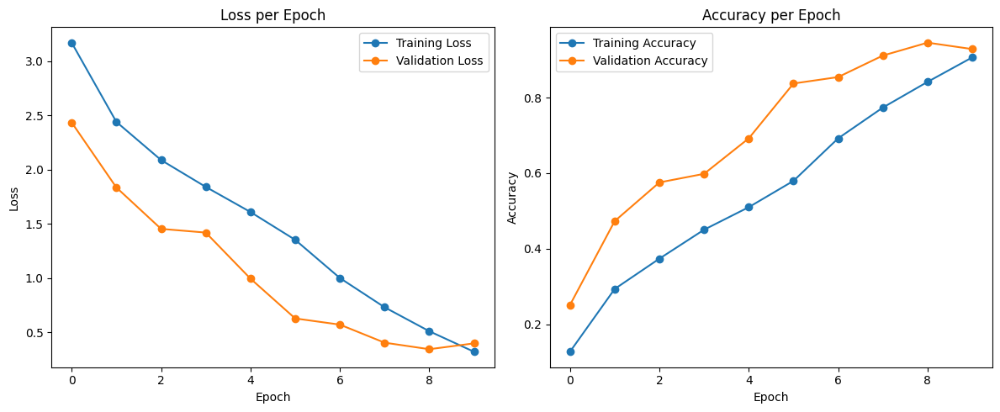

In [105]:

ten_epoch_model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

# Compile the ten_epoch_model.
ten_epoch_model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

ten_epoch_model.summary()

# Train the ten_epoch_model.
ten_epoch_history = ten_epoch_model.fit(
    train_images, train_labels,
    epochs=10,
    validation_data=(val_images, val_labels)
)

# Plot training and validation loss and accuracy per epoch.
plt.figure(figsize=(12, 5))

# Plot Loss
plt.subplot(1, 2, 1)
plt.plot(ten_epoch_history.history['loss'], marker='o', label='Training Loss')
plt.plot(ten_epoch_history.history['val_loss'], marker='o', label='Validation Loss')
plt.title("Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()

# Plot Accuracy
plt.subplot(1, 2, 2)
plt.plot(ten_epoch_history.history['accuracy'], marker='o', label='Training Accuracy')
plt.plot(ten_epoch_history.history['val_accuracy'], marker='o', label='Validation Accuracy')
plt.title("Accuracy per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


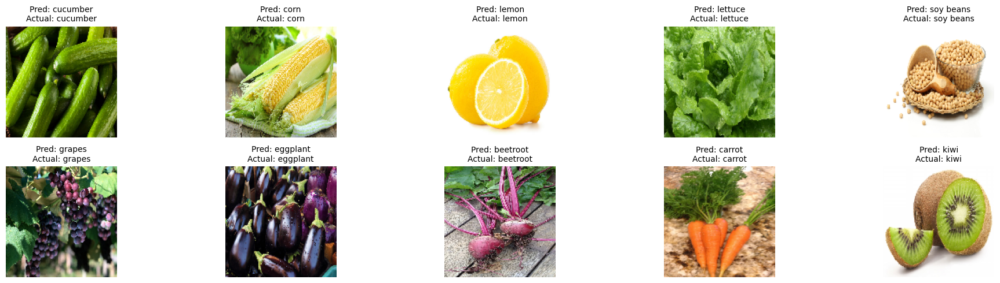

In [106]:
# Choose 10 random indices from the validation dataset.
num_samples = 10
random_indices = np.random.choice(len(val_images), size=num_samples, replace=False)

# Select the images corresponding to these indices
selected_images = val_images[random_indices]
# Predict the classes for these images
predictions = ten_epoch_model.predict(selected_images)
pred_labels = np.argmax(predictions, axis=1)
actual_labels = val_labels[random_indices]

# Plot the images with predicted and actual labels
plt.figure(figsize=(20, 5))
for i in range(num_samples):
    idx = random_indices[i]
    plt.subplot(2, 5, i+1)
    plt.imshow(val_images[idx])
    plt.axis("off")
    plt.title(f"Pred: {categories[pred_labels[i]]}\nActual: {categories[actual_labels[i]]}", fontsize=10)
plt.tight_layout()
plt.show()

# Pretrained Models
## MobileNetV2 with GlobalAveragePooling2D + Dense output layer

#### Pretrained MobileNetV2 model used for efficient feature extraction.
#### Base model (MobileNetV2) loaded with ImageNet weights, allowing transfer learning.
#### include_top=False removes the original classification layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), preventing unnecessary modifications to pretrained weights.
#### Preprocessing step (Lambda layer) ensures input images are properly scaled for MobileNetV2.
#### GlobalAveragePooling2D layer replaces fully connected layers, reducing parameters and overfitting.
#### Dense softmax output layer classifies into 36 classes.
#### Lightweight and optimized for speed, making it suitable for real-time applications.

Model: "sequential_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_24 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_128            │ (None, 4, 4, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_13     │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_55 (Dense)                │ (None, 36)             │        46,116 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,304,100 (8.79 MB)

 Trainable params: 46,116 (180.14 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

Epoch 1/10
98/98 - 12s - 126ms/step - accuracy: 0.5366 - loss: 1.7728 - val_accuracy: 0.8604 - val_loss: 0.5486
Epoch 2/10
98/98 - 9s - 96ms/step - accuracy: 0.8144 - loss: 0.6503 - val_accuracy: 0.9145 - val_loss: 0.3297
Epoch 3/10
98/98 - 8s - 85ms/step - accuracy: 0.8876 - loss: 0.4271 - val_accuracy: 0.9316 - val_loss: 0.2509
Epoch 4/10
98/98 - 9s - 91ms/step - accuracy: 0.9294 - loss: 0.3051 - val_accuracy: 0.9459 - val_loss: 0.2115
Epoch 5/10
98/98 - 9s - 87ms/step - accuracy: 0.9550 - loss: 0.2306 - val_accuracy: 0.9544 - val_loss: 0.1842
Epoch 6/10
98/98 - 9s - 90ms/step - accuracy: 0.9669 - loss: 0.1777 - val_accuracy: 0.9601 - val_loss: 0.1608
Epoch 7/10
98/98 - 8s - 81ms/step - accuracy: 0.9724 - loss: 0.1463 - val_accuracy: 0.9601 - val_loss: 0.1494
Epoch 8/10
98/98 - 9s - 88ms/step - accuracy: 0.9811 - loss: 0.1199 - val_accuracy: 0.9658 - val_loss: 0.1348
Epoch 9/10
98/98 - 10s - 97ms/step - accuracy: 0.9865 - loss: 0.1001 - val_accuracy: 0.9687 - val_loss: 0.1262
Epoch 1

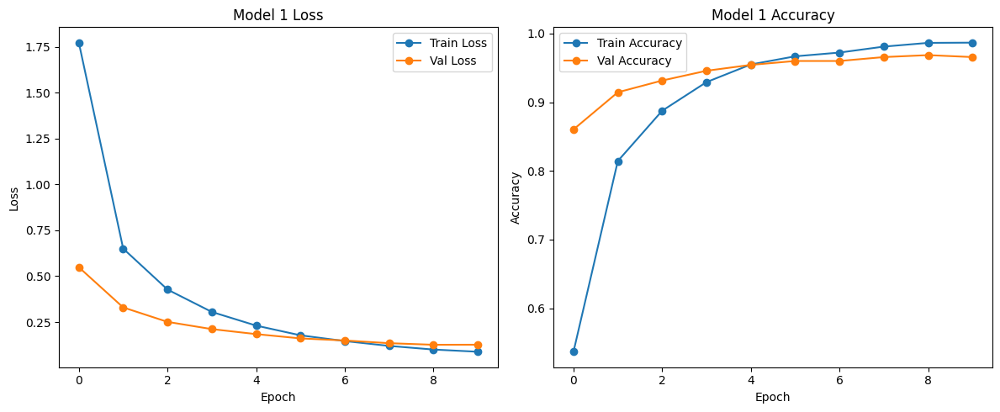

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


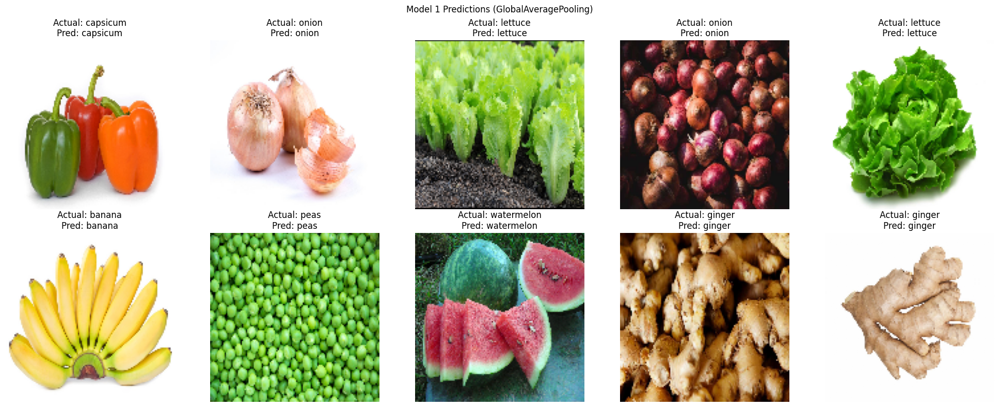

In [107]:
base_model_1 = MobileNetV2(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_1.trainable = False

# Build Model 1: GlobalAveragePooling2D + Dense output layer.
mobilenetv2_global = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    # MobileNetV2 expects inputs in a specific range.
    tf.keras.layers.Lambda(lambda x: preprocess_input_mbnv2(x * 255.0)),
    base_model_1,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

mobilenetv2_global.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
mobilenetv2_global.summary()

# Train Model 1
history_1 = mobilenetv2_global.fit(train_images, train_labels, epochs=10, validation_data=(val_images, val_labels), verbose=2)

# Plot training history for Model 1
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history_1.history['loss'], marker='o', label='Train Loss')
plt.plot(history_1.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 1 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1,2,2)
plt.plot(history_1.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_1.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 1 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Plot predictions on 10 random validation images (Model 1)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_1 = mobilenetv2_global.predict(selected_val_images)
pred_labels_1 = np.argmax(preds_1, axis=1)

plt.figure(figsize=(20,8))
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_1[i]]}")
    plt.axis("off")
plt.suptitle("Model 1 Predictions (GlobalAveragePooling)")
plt.tight_layout()
plt.show()

## MobileNetV2 with Dropouts and Dense(256)

#### Pretrained MobileNetV2 model used for feature extraction, loaded with ImageNet weights.
#### include_top=False removes the original classification layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), preserving learned features from ImageNet.
#### Preprocessing step (Lambda layer) ensures images are correctly scaled for MobileNetV2.
#### Flatten layer converts extracted feature maps into a 1D vector, retaining all spatial details.
#### Dense layer (256 neurons, ReLU activation) increases model capacity for classification.
#### Dropout layer (rate = 0.5) randomly deactivates neurons to reduce overfitting.
#### Dense softmax output layer classifies into 36 classes.
#### More parameters than GlobalAveragePooling2D, increasing computational cost and risk of overfitting.
#### Tends to perform worse than GlobalAveragePooling2D due to unnecessary additional layers.
#### Less efficient for generalization, as Dropout removes useful feature information from the pretrained model.

Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_25 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_128            │ (None, 4, 4, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 20480)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_56 (Dense)                │ (None, 256)            │     5,243,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_11 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_57 (Dense)                │ (None, 36)             │         9,252 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,510,372 (28.65 MB)

 Trainable params: 5,252,388 (20.04 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

Epoch 1/10
98/98 - 14s - 144ms/step - accuracy: 0.4085 - loss: 2.4425 - val_accuracy: 0.8803 - val_loss: 0.4325
Epoch 2/10
98/98 - 8s - 87ms/step - accuracy: 0.6484 - loss: 1.3018 - val_accuracy: 0.9288 - val_loss: 0.2303
Epoch 3/10
98/98 - 10s - 106ms/step - accuracy: 0.7161 - loss: 0.9469 - val_accuracy: 0.9259 - val_loss: 0.2074
Epoch 4/10
98/98 - 8s - 86ms/step - accuracy: 0.7742 - loss: 0.7728 - val_accuracy: 0.9430 - val_loss: 0.1607
Epoch 5/10
98/98 - 11s - 109ms/step - accuracy: 0.8031 - loss: 0.6501 - val_accuracy: 0.9516 - val_loss: 0.1582
Epoch 6/10
98/98 - 8s - 87ms/step - accuracy: 0.8346 - loss: 0.5487 - val_accuracy: 0.9573 - val_loss: 0.1564
Epoch 7/10
98/98 - 9s - 87ms/step - accuracy: 0.8382 - loss: 0.5197 - val_accuracy: 0.9601 - val_loss: 0.1572
Epoch 8/10
98/98 - 11s - 107ms/step - accuracy: 0.8523 - loss: 0.4743 - val_accuracy: 0.9658 - val_loss: 0.1221
Epoch 9/10
98/98 - 9s - 87ms/step - accuracy: 0.8683 - loss: 0.4213 - val_accuracy: 0.9687 - val_loss: 0.1759
Ep

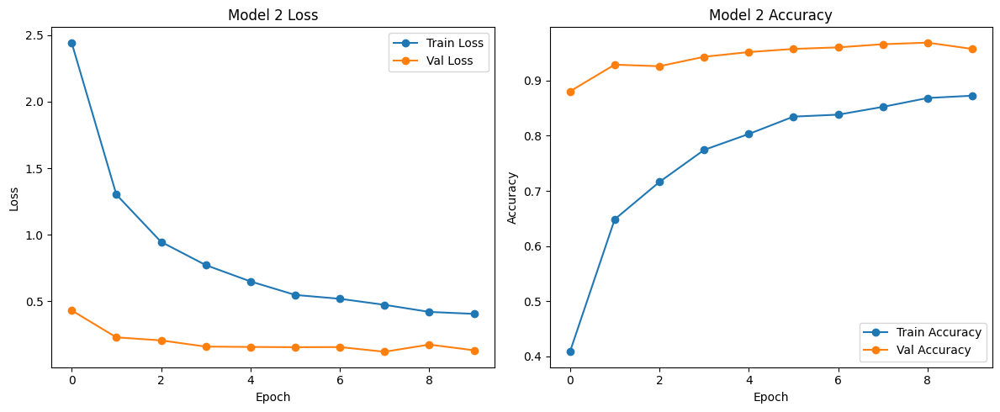

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


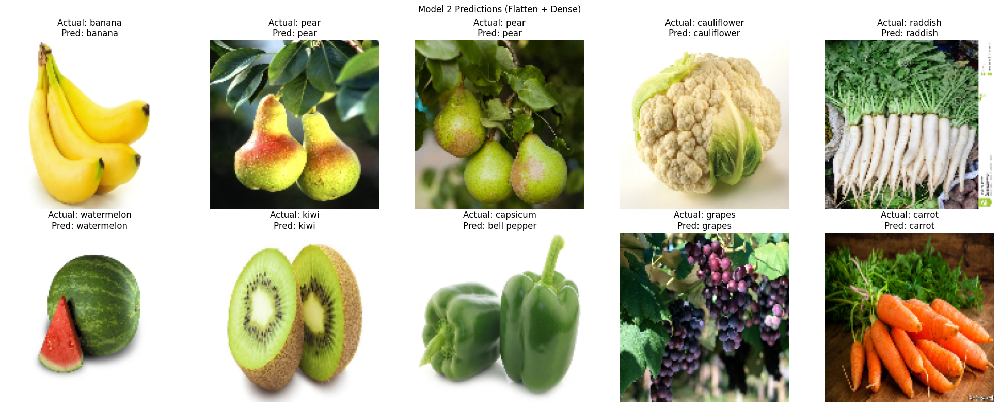

In [108]:
base_model_2 = MobileNetV2(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_2.trainable = False

# Build Model 2: Flatten the base output, add Dense(256) with dropout, then output layer.
mobilenetv2_dropouts = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    tf.keras.layers.Lambda(lambda x: preprocess_input_mbnv2(x * 255.0)),
    base_model_2,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

mobilenetv2_dropouts.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
mobilenetv2_dropouts.summary()

# Train Model 2
history_2 = mobilenetv2_dropouts.fit(train_images, train_labels, epochs=10, validation_data=(val_images, val_labels), verbose=2)

# Plot training history for Model 2
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history_2.history['loss'], marker='o', label='Train Loss')
plt.plot(history_2.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 2 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1,2,2)
plt.plot(history_2.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_2.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 2 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Plot predictions on 10 random validation images (Model 2)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_2 = mobilenetv2_dropouts.predict(selected_val_images)
pred_labels_2 = np.argmax(preds_2, axis=1)

plt.figure(figsize=(20,8))
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_2[i]]}")
    plt.axis("off")
plt.suptitle("Model 2 Predictions (Flatten + Dense)")
plt.tight_layout()
plt.show()

## ResNetV50 with GlobalAveragePooling2D

#### Pretrained ResNet50 model used for feature extraction, initialized with ImageNet weights.
#### include_top=False removes original fully connected layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), preventing unnecessary modifications to pretrained weights.
#### Preprocessing step (Lambda layer) ensures images are correctly scaled for ResNet50.
#### GlobalAveragePooling2D layer replaces fully connected layers, summarizing feature maps to prevent overfitting.
#### Dense softmax output layer classifies into 36 classes.
#### ResNet50’s residual connections improve gradient flow, enabling deeper feature extraction and better accuracy.
#### More powerful than MobileNetV2, as it captures richer feature representations.
#### Achieves the best performance among all tested models, balancing accuracy and efficiency.
#### Ideal for complex classification tasks, making it the final choice for the project.

Model: "sequential_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_26 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 4, 4, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_14     │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_58 (Dense)                │ (None, 36)             │        73,764 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,661,476 (90.26 MB)

 Trainable params: 73,764 (288.14 KB)

 Non-trainable params: 23,587,712 (89.98 MB)

Epoch 1/10
98/98 - 34s - 348ms/step - accuracy: 0.5273 - loss: 1.8639 - val_accuracy: 0.8746 - val_loss: 0.4607
Epoch 2/10
98/98 - 27s - 275ms/step - accuracy: 0.8285 - loss: 0.5882 - val_accuracy: 0.9202 - val_loss: 0.3124
Epoch 3/10
98/98 - 27s - 275ms/step - accuracy: 0.8972 - loss: 0.3388 - val_accuracy: 0.9430 - val_loss: 0.2366
Epoch 4/10
98/98 - 27s - 277ms/step - accuracy: 0.9416 - loss: 0.2191 - val_accuracy: 0.9288 - val_loss: 0.2334
Epoch 5/10
98/98 - 27s - 278ms/step - accuracy: 0.9666 - loss: 0.1526 - val_accuracy: 0.9459 - val_loss: 0.1933
Epoch 6/10
98/98 - 22s - 227ms/step - accuracy: 0.9724 - loss: 0.1237 - val_accuracy: 0.9601 - val_loss: 0.1725
Epoch 7/10
98/98 - 14s - 139ms/step - accuracy: 0.9823 - loss: 0.0854 - val_accuracy: 0.9630 - val_loss: 0.1717
Epoch 8/10
98/98 - 14s - 141ms/step - accuracy: 0.9839 - loss: 0.0769 - val_accuracy: 0.9687 - val_loss: 0.1514
Epoch 9/10
98/98 - 14s - 144ms/step - accuracy: 0.9849 - loss: 0.0674 - val_accuracy: 0.9687 - val_loss:

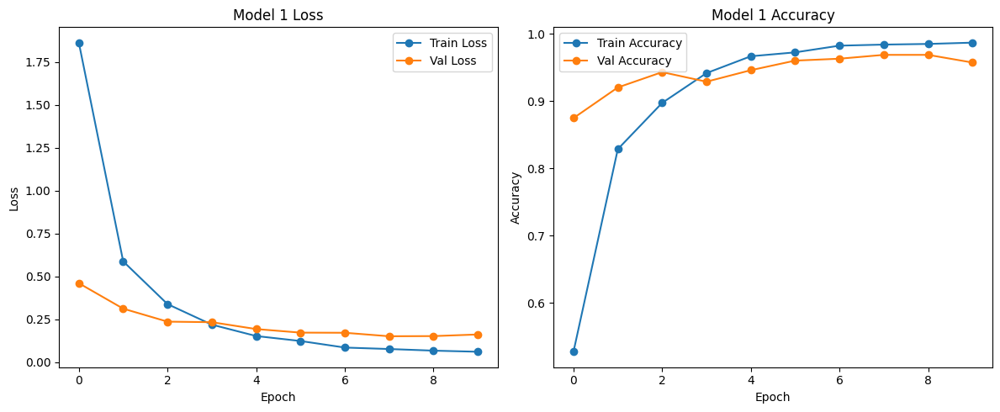

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 935ms/step


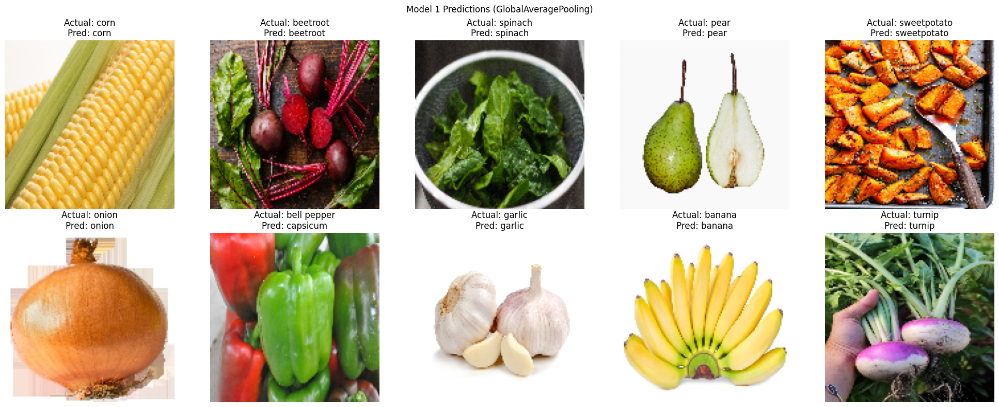

In [109]:
# Build Model 1 using ResNet50 as base and GlobalAveragePooling2D as head.
base_model_3 = ResNet50(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_3.trainable = False  # Freeze the base

resnet50_global = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    # ResNet50's preprocess_input expects pixel values in [0,255]
    tf.keras.layers.Lambda(lambda x: preprocess_input_rsn50(x * 255.0)),
    base_model_3,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

resnet50_global.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
resnet50_global.summary()

# Train Model 1
history_3 = resnet50_global.fit(train_images, train_labels, epochs=10, validation_data=(val_images, val_labels), verbose=2)

# Plot training history for Model 1
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history_3.history['loss'], marker='o', label='Train Loss')
plt.plot(history_3.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 1 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history_3.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_3.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 1 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Plot predictions on 10 random validation images (Model 1)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_1 = resnet50_global.predict(selected_val_images)
pred_labels_1 = np.argmax(preds_1, axis=1)

plt.figure(figsize=(20, 8))
for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_1[i]]}")
    plt.axis("off")
plt.suptitle("Model 1 Predictions (GlobalAveragePooling)")
plt.tight_layout()
plt.show()

## ResNetV50 with Flatten + Dropouts

#### Pretrained ResNet50 model used for feature extraction, loaded with ImageNet weights.
#### include_top=False removes original classification layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), ensuring the learned ImageNet features remain intact.
#### Preprocessing step (Lambda layer) scales images correctly for ResNet50.
#### Flatten layer converts the feature maps into a 1D vector, retaining all extracted spatial details.
#### Dense layer (256 neurons, ReLU activation) adds trainable parameters for classification.
#### Dropout layer (rate = 0.5) prevents overfitting by randomly deactivating neurons.
#### Dense softmax output layer classifies into 36 classes.
#### More parameters than GlobalAveragePooling2D, leading to increased computation and memory usage.
#### Weaker generalization performance, as Dropout may remove useful pretrained feature information.
#### Overfitting risk is higher, making it less efficient compared to GlobalAveragePooling2D.
#### Did not perform as well as ResNet50 with GlobalAveragePooling2D, reinforcing the importance of selecting appropriate feature extraction techniques.

Model: "sequential_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_27 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 4, 4, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_59 (Dense)                │ (None, 256)            │     8,388,864 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 36)             │         9,252 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 31,985,828 (122.02 MB)

 Trainable params: 8,398,116 (32.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

Epoch 1/10
98/98 - 20s - 202ms/step - accuracy: 0.1760 - loss: 4.1872 - val_accuracy: 0.5071 - val_loss: 1.8044
Epoch 2/10
98/98 - 16s - 160ms/step - accuracy: 0.3128 - loss: 2.5623 - val_accuracy: 0.6097 - val_loss: 1.3101
Epoch 3/10
98/98 - 16s - 159ms/step - accuracy: 0.3812 - loss: 2.3013 - val_accuracy: 0.7123 - val_loss: 1.0604
Epoch 4/10
98/98 - 16s - 164ms/step - accuracy: 0.4274 - loss: 2.1461 - val_accuracy: 0.7293 - val_loss: 0.8621
Epoch 5/10
98/98 - 19s - 197ms/step - accuracy: 0.4762 - loss: 1.8578 - val_accuracy: 0.7892 - val_loss: 0.6729
Epoch 6/10
98/98 - 16s - 165ms/step - accuracy: 0.4894 - loss: 1.7459 - val_accuracy: 0.7778 - val_loss: 0.6196
Epoch 7/10
98/98 - 16s - 162ms/step - accuracy: 0.5026 - loss: 1.7042 - val_accuracy: 0.7835 - val_loss: 0.6111
Epoch 8/10
98/98 - 16s - 164ms/step - accuracy: 0.5356 - loss: 1.6054 - val_accuracy: 0.8376 - val_loss: 0.5277
Epoch 9/10
98/98 - 16s - 162ms/step - accuracy: 0.5238 - loss: 1.6450 - val_accuracy: 0.8376 - val_loss:

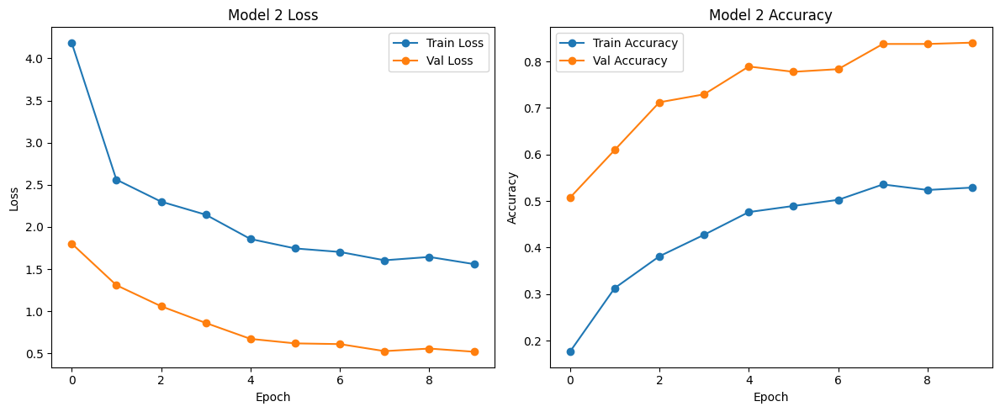

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step


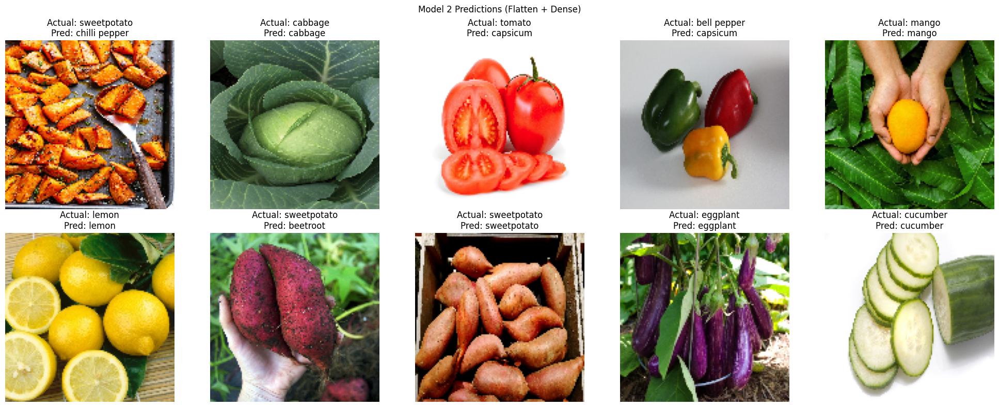

In [110]:
# Build Model 2 using ResNet50 as base and a custom head with Flatten + Dense layers.
base_model_4 = ResNet50(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_4.trainable = False  # Freeze the base

resnet50_dropouts = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    # Apply ResNet50 preprocessing: scale input to [0,255] then preprocess.
    tf.keras.layers.Lambda(lambda x: preprocess_input_rsn50(x * 255.0)),
    base_model_4,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

resnet50_dropouts.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
resnet50_dropouts.summary()

# Train Model 2
history_2 = resnet50_dropouts.fit(train_images, train_labels, epochs=10, validation_data=(val_images, val_labels), verbose=2)

# Plot training history for Model 2
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history_2.history['loss'], marker='o', label='Train Loss')
plt.plot(history_2.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 2 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(history_2.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_2.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 2 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Plot predictions on 10 random validation images (Model 2)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_2 = resnet50_dropouts.predict(selected_val_images)
pred_labels_2 = np.argmax(preds_2, axis=1)

plt.figure(figsize=(20, 8))
for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_2[i]]}")
    plt.axis("off")
plt.suptitle("Model 2 Predictions (Flatten + Dense)")
plt.tight_layout()
plt.show()

## EfficientNet with GlobalAveragePooling2D

#### Pretrained EfficientNetB0 model used for feature extraction, initialized with ImageNet weights.
#### include_top=False removes the original classification layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), preventing unnecessary modifications to pretrained weights.
#### Preprocessing step (Lambda layer) ensures images are correctly scaled for EfficientNetB0.
#### GlobalAveragePooling2D layer replaces fully connected layers, reducing overfitting and improving efficiency.
#### Dense softmax output layer classifies into 36 classes.
#### More efficient than ResNet50, offering a balance between accuracy and computational cost.
#### Performs well in generalization, particularly for datasets with varied image conditions.
#### Lightweight and optimized, making it suitable for real-time applications.
#### A strong alternative to MobileNetV2, but ResNet50 still performed better in accuracy for this project.

Model: "sequential_43"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_28 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 4, 4, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_15     │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 36)             │        46,116 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,095,687 (15.62 MB)

 Trainable params: 46,116 (180.14 KB)

 Non-trainable params: 4,049,571 (15.45 MB)

Epoch 1/10
98/98 - 13s - 138ms/step - accuracy: 0.5196 - loss: 2.0684 - val_accuracy: 0.8490 - val_loss: 0.7890
Epoch 2/10
98/98 - 8s - 78ms/step - accuracy: 0.7871 - loss: 0.8922 - val_accuracy: 0.9060 - val_loss: 0.4586
Epoch 3/10
98/98 - 8s - 78ms/step - accuracy: 0.8433 - loss: 0.6423 - val_accuracy: 0.9202 - val_loss: 0.3401
Epoch 4/10
98/98 - 8s - 78ms/step - accuracy: 0.8703 - loss: 0.5162 - val_accuracy: 0.9288 - val_loss: 0.2779
Epoch 5/10
98/98 - 8s - 78ms/step - accuracy: 0.8915 - loss: 0.4324 - val_accuracy: 0.9487 - val_loss: 0.2387
Epoch 6/10
98/98 - 8s - 78ms/step - accuracy: 0.9101 - loss: 0.3693 - val_accuracy: 0.9658 - val_loss: 0.2094
Epoch 7/10
98/98 - 8s - 78ms/step - accuracy: 0.9258 - loss: 0.3173 - val_accuracy: 0.9573 - val_loss: 0.1892
Epoch 8/10
98/98 - 8s - 77ms/step - accuracy: 0.9361 - loss: 0.2825 - val_accuracy: 0.9630 - val_loss: 0.1747
Epoch 9/10
98/98 - 8s - 78ms/step - accuracy: 0.9441 - loss: 0.2514 - val_accuracy: 0.9573 - val_loss: 0.1657
Epoch 10

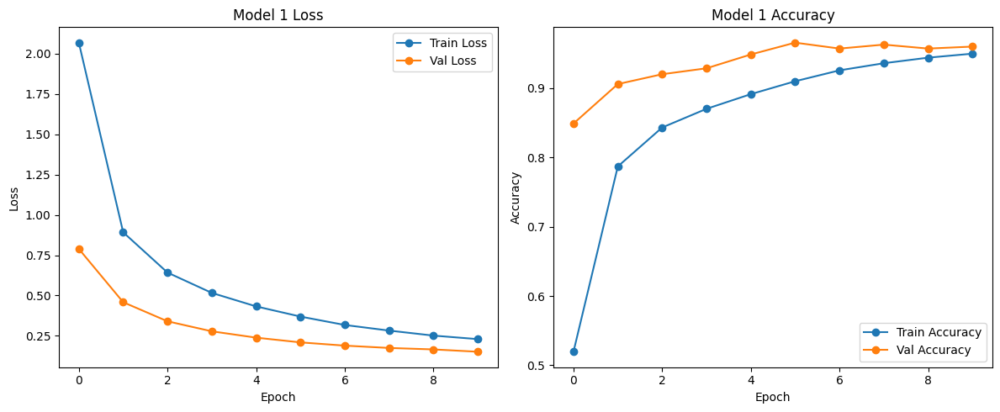

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   


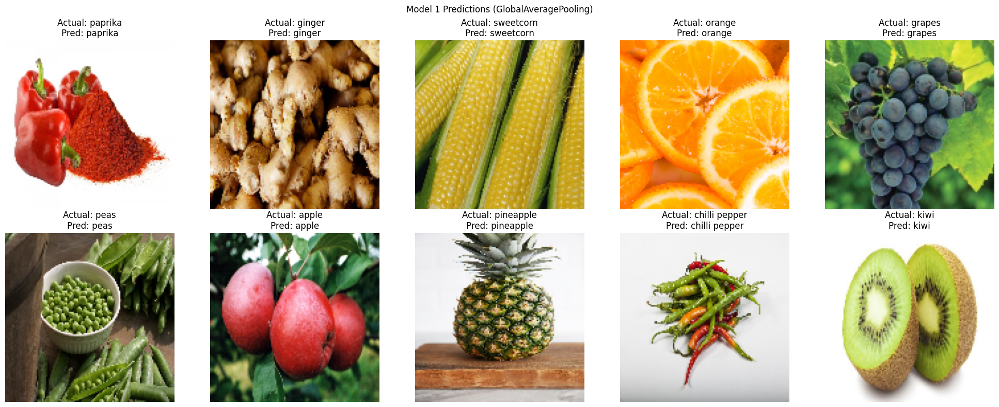

In [111]:
# Create the EfficientNetB0 base (frozen)
base_model_5 = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_5.trainable = False

# Build Model 1: EfficientNetB0 with GlobalAveragePooling2D head
efficientNetB0_global = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    # EfficientNetB0's preprocess_input expects inputs in [0, 255]
    tf.keras.layers.Lambda(lambda x: preprocess_input_en(x * 255.0)),
    base_model_5,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

efficientNetB0_global.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])
efficientNetB0_global.summary()

# Train Model 1
history_1 = efficientNetB0_global.fit(train_images, train_labels,
                        epochs=10,
                        validation_data=(val_images, val_labels),
                        verbose=2)

# Plot training history for Model 1
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history_1.history['loss'], marker='o', label='Train Loss')
plt.plot(history_1.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 1 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1,2,2)
plt.plot(history_1.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_1.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 1 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Predict on 10 random validation images (Model 1)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_1 = efficientNetB0_global.predict(selected_val_images)
pred_labels_1 = np.argmax(preds_1, axis=1)

plt.figure(figsize=(20,8))
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_1[i]]}")
    plt.axis("off")
plt.suptitle("Model 1 Predictions (GlobalAveragePooling)")
plt.tight_layout()
plt.show()

## EfficientNet with Flatten + Dropouts

#### Pretrained EfficientNetB0 model used for feature extraction, initialized with ImageNet weights.
#### include_top=False removes the original fully connected layers, keeping only the feature extractor.
#### Base model is frozen (trainable=False), ensuring the pretrained features remain intact.
#### Preprocessing step (Lambda layer) scales images correctly for EfficientNetB0.
#### Flatten layer converts feature maps into a 1D vector, preserving detailed spatial features.
#### Dense layer (256 neurons, ReLU activation) increases model capacity for classification.
#### Dropout layer (rate = 0.5) randomly deactivates neurons to reduce overfitting.
#### Dense softmax output layer classifies into 36 classes.
#### More parameters than GlobalAveragePooling2D, making it computationally more expensive.
#### Higher risk of overfitting, as Flatten retains unnecessary details from feature maps.
#### Weaker generalization performance compared to GlobalAveragePooling2D, due to excessive fully connected layers.
#### Did not perform as well as EfficientNetB0 with GlobalAveragePooling2D, reinforcing the importance of efficient feature summarization.

Model: "sequential_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lambda_29 (Lambda)              │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 4, 4, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 20480)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 256)            │     5,243,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 36)             │         9,252 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,301,959 (35.48 MB)

 Trainable params: 5,252,388 (20.04 MB)

 Non-trainable params: 4,049,571 (15.45 MB)

Epoch 1/10
98/98 - 15s - 151ms/step - accuracy: 0.5048 - loss: 2.0727 - val_accuracy: 0.9259 - val_loss: 0.2784
Epoch 2/10
98/98 - 9s - 89ms/step - accuracy: 0.7656 - loss: 0.8002 - val_accuracy: 0.9544 - val_loss: 0.1639
Epoch 3/10
98/98 - 9s - 89ms/step - accuracy: 0.8359 - loss: 0.5322 - val_accuracy: 0.9658 - val_loss: 0.1188
Epoch 4/10
98/98 - 9s - 88ms/step - accuracy: 0.8677 - loss: 0.4491 - val_accuracy: 0.9402 - val_loss: 0.2211
Epoch 5/10
98/98 - 9s - 97ms/step - accuracy: 0.8950 - loss: 0.3482 - val_accuracy: 0.9658 - val_loss: 0.1116
Epoch 6/10
98/98 - 9s - 88ms/step - accuracy: 0.9069 - loss: 0.3233 - val_accuracy: 0.9573 - val_loss: 0.1402
Epoch 7/10
98/98 - 9s - 88ms/step - accuracy: 0.8979 - loss: 0.3202 - val_accuracy: 0.9715 - val_loss: 0.1085
Epoch 8/10
98/98 - 8s - 86ms/step - accuracy: 0.9255 - loss: 0.2368 - val_accuracy: 0.9601 - val_loss: 0.1130
Epoch 9/10
98/98 - 8s - 86ms/step - accuracy: 0.9197 - loss: 0.2688 - val_accuracy: 0.9715 - val_loss: 0.0872
Epoch 10

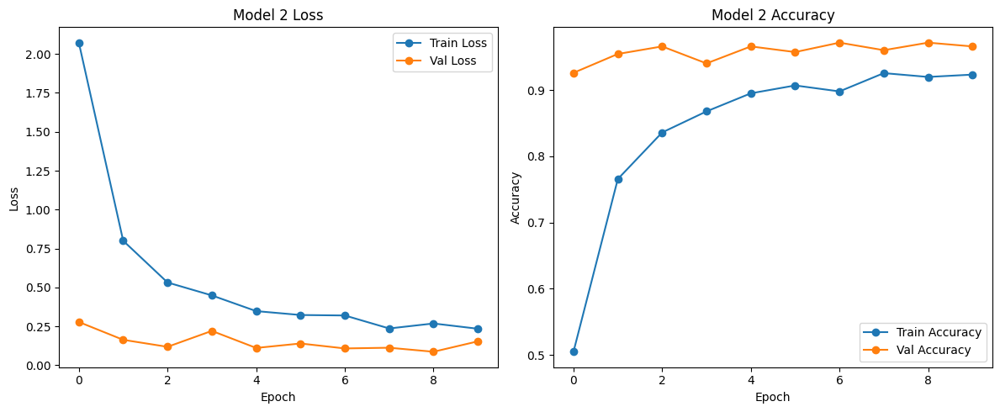

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


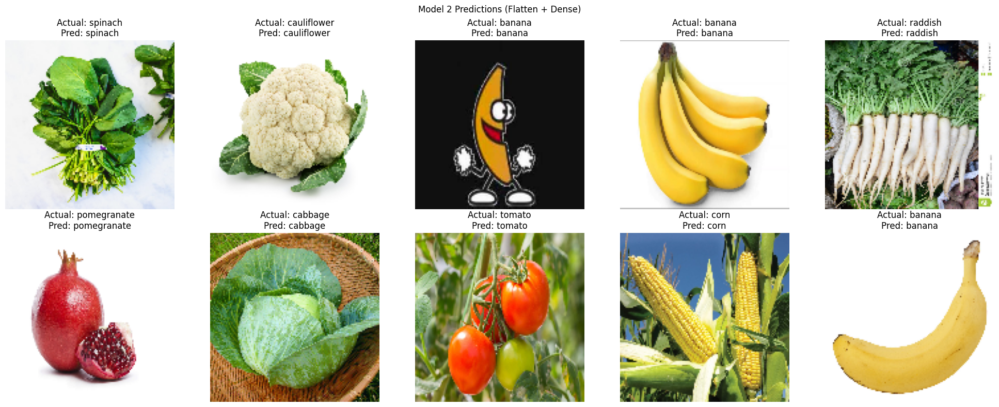

In [112]:
# Create the EfficientNetB0 base (frozen)
base_model_6 = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base_model_6.trainable = False

# Build Model 2: EfficientNetB0 with Flatten, Dense, and Dropout layers
efficientnetB0_dropouts = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(IMG_SIZE[0], IMG_SIZE[1], 3)),
    tf.keras.layers.Lambda(lambda x: preprocess_input_en(x * 255.0)),
    base_model_6,
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

efficientnetB0_dropouts.compile(optimizer='adam',
                loss='sparse_categorical_crossentropy',
                metrics=['accuracy'])
efficientnetB0_dropouts.summary()

# Train Model 2
history_2 = efficientnetB0_dropouts.fit(train_images, train_labels,
                        epochs=10,
                        validation_data=(val_images, val_labels),
                        verbose=2)

# Plot training history for Model 2
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history_2.history['loss'], marker='o', label='Train Loss')
plt.plot(history_2.history['val_loss'], marker='o', label='Val Loss')
plt.title("Model 2 Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.subplot(1,2,2)
plt.plot(history_2.history['accuracy'], marker='o', label='Train Accuracy')
plt.plot(history_2.history['val_accuracy'], marker='o', label='Val Accuracy')
plt.title("Model 2 Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

# Predict on 10 random validation images (Model 2)
indices = random.sample(range(val_images.shape[0]), 10)
selected_val_images = val_images[indices]
selected_val_labels = val_labels[indices]
preds_2 = efficientnetB0_dropouts.predict(selected_val_images)
pred_labels_2 = np.argmax(preds_2, axis=1)

plt.figure(figsize=(20,8))
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(selected_val_images[i])
    plt.title(f"Actual: {categories[selected_val_labels[i]]}\nPred: {categories[pred_labels_2[i]]}")
    plt.axis("off")
plt.suptitle("Model 2 Predictions (Flatten + Dense)")
plt.tight_layout()
plt.show()

# Final Best model Prediction Verification

[%] Downloading Images to c:\Users\mi6xi\OneDrive\Desktop\Deep_learning\bing_verification_images\apple


[!!]Indexing page: 1

[%] Indexed 1 Images on Page 1.


[%] Downloading Image #1 from https://logo.com/image-cdn/images/kts928pd/production/cfe98f0d8e42613968a2414d95c9064037d78580-1140x620.png?w=3840&amp;q=80
[%] File Downloaded !



[%] Done. Downloaded 1 images.
[%] Downloading Images to c:\Users\mi6xi\OneDrive\Desktop\Deep_learning\bing_verification_images\banana


[!!]Indexing page: 1

[%] Indexed 61 Images on Page 1.


[%] Downloading Image #1 from http://www.somethingcool.ca/wp-content/uploads/2016/06/Bananans-Works-of-Art-07.jpg
[!] Issue getting: http://www.somethingcool.ca/wp-content/uploads/2016/06/Bananans-Works-of-Art-07.jpg
[!] Error:: <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:1006)>
[%] Downloading Image #1 from http://mymodernmet.com/wp/wp-content/uploads/2016/12/isteef-banana-art-2.jpg
[

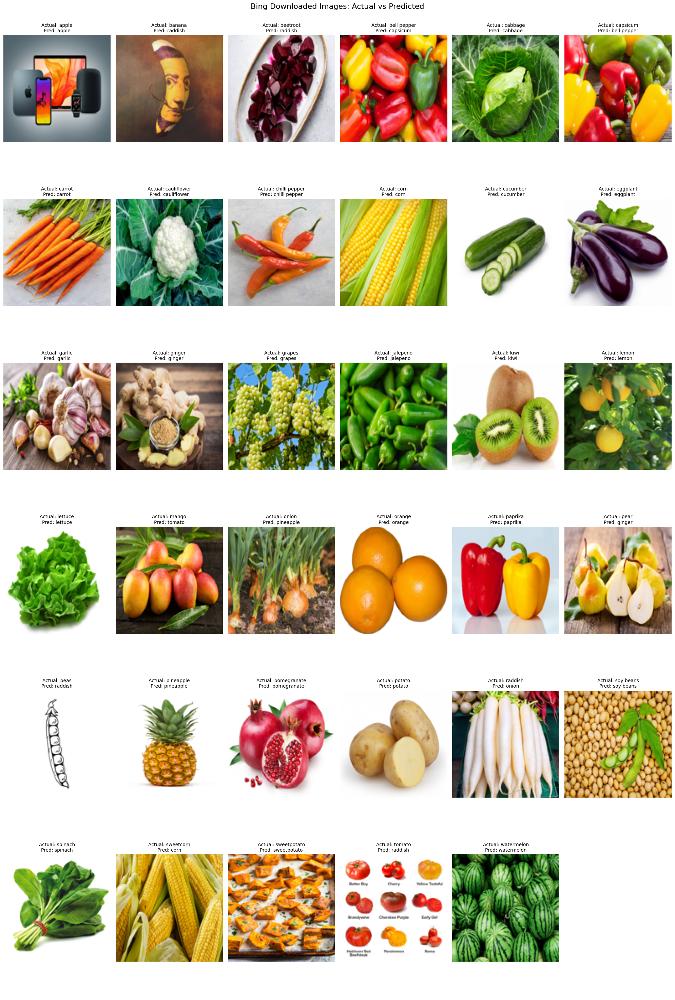

In [113]:
# Constants and directories
NUM_CLASSES = 36
IMG_SIZE = (128, 128)
VERIFY_DIR = "bing_verification_images"


# Download one image for each class (each query folder is named after the query)
for query in categories:
    print(f"Downloading image for category: {query}")
    downloader.download(query, 
                        limit=1, 
                        output_dir=VERIFY_DIR, 
                        adult_filter_off=False, 
                        force_replace=False, 
                        timeout=60, 
                        verbose=True)

# Collect one downloaded image per category.
downloaded_images = []
actual_labels = []
for query in categories:
    folder = os.path.join(VERIFY_DIR, query)
    # Look for jpg images in the folder.
    img_files = glob.glob(os.path.join(folder, "*.jpg"))
    if img_files:
        downloaded_images.append(img_files[0])
        actual_labels.append(query)
    else:
        print(f"No image found for category: {query}")

if len(downloaded_images) != NUM_CLASSES:
    print(f"Warning: Expected {NUM_CLASSES} images but found {len(downloaded_images)}.")

# Preprocessing function: load image, convert to RGB, resize, and normalize.
def load_and_preprocess_image(path):
    img = Image.open(path).convert("RGB")
    img = img.resize(IMG_SIZE)
    img_array = np.array(img).astype(np.float32) / 255.0
    return img_array

# Load and preprocess all images.
images = np.stack([load_and_preprocess_image(p) for p in downloaded_images])

# Get predictions from your trained model.
# (Assumes model_2 is already defined and loaded with your custom weights.)
predictions = resnet50_global.predict(images)
predicted_indices = np.argmax(predictions, axis=1)
predicted_labels = [categories[i] for i in predicted_indices]

# Plot all 36 images in a 6x6 grid with actual vs predicted labels.
fig, axes = plt.subplots(6, 6, figsize=(20, 30))
axes = axes.flatten()
for i in range(len(images)):
    axes[i].imshow(images[i])
    axes[i].set_title(f"Actual: {actual_labels[i]}\nPred: {predicted_labels[i]}", fontsize=10)
    axes[i].axis("off")
# If there are fewer than 36 images, hide any extra subplots.
for j in range(len(images), 36):
    axes[j].axis("off")
plt.suptitle("Bing Downloaded Images: Actual vs Predicted", fontsize=16)
plt.tight_layout()
plt.show()